# Assignment 4


In [ ]:
import warnings
warnings.filterwarnings('ignore')

# File 1: Star Wars


In [ ]:
import librosa
audio_path = 'StarWars60.wav'
x , sr = librosa.load(audio_path)

In [ ]:
import IPython.display as ipd
ipd.Audio(audio_path)

## Visualizing Audio

In [ ]:
%matplotlib inline
import sklearn
import matplotlib.pyplot as plt
import librosa.display


waveform

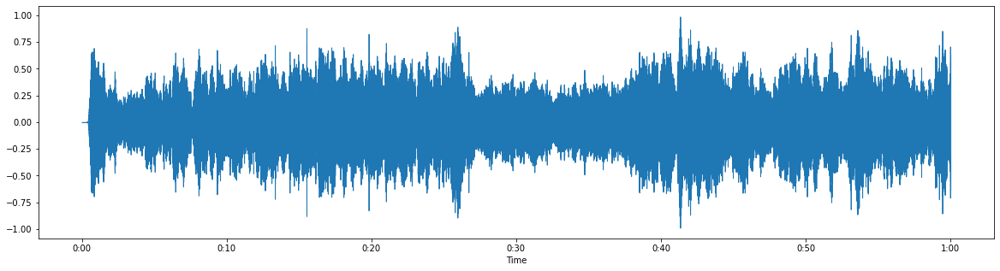

In [ ]:
plt.figure(figsize=(20, 5))
librosa.display.waveshow(x, sr=sr)

Spectogram

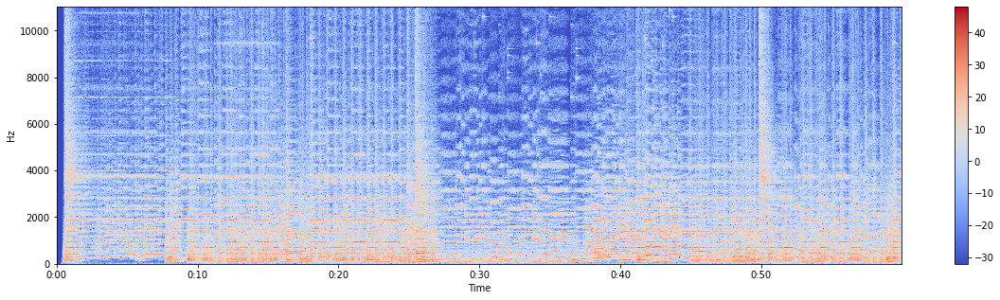

In [ ]:
X = librosa.stft(x)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(20, 5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar()


Log Frequency axis


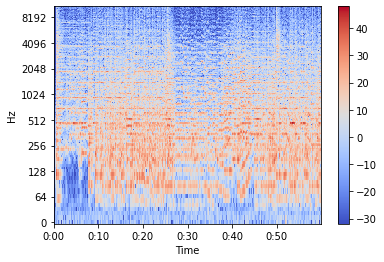

In [ ]:
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.colorbar()

## Create Audio Signal

In [ ]:
import numpy as np
sr = 22050 # sample rate
T = 5.0    # seconds
t = np.linspace(0, T, int(T*sr), endpoint=False) # time variable
x = 0.5*np.sin(2*np.pi*220*t)# pure sine wave at 220 Hz

In [ ]:
ipd.Audio(x, rate=sr) # load a NumPy array

In [ ]:
import soundfile as sf
sf.write('./tone_440.wav', x, sr) # writing wave file in tone440.wav format

Feature Extraction


In [ ]:
x, sr = librosa.load('./StarWars60.wav')
ipd.Audio(x, rate=sr)

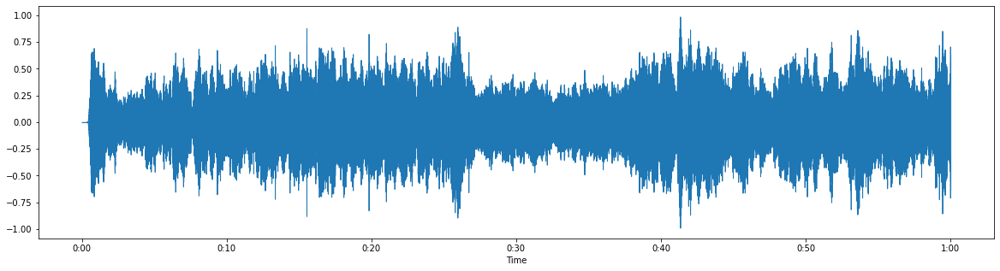

In [ ]:
#Plot the signal:
plt.figure(figsize=(20, 5))
librosa.display.waveshow(x, sr=sr)

1. Zero Crossing Rate

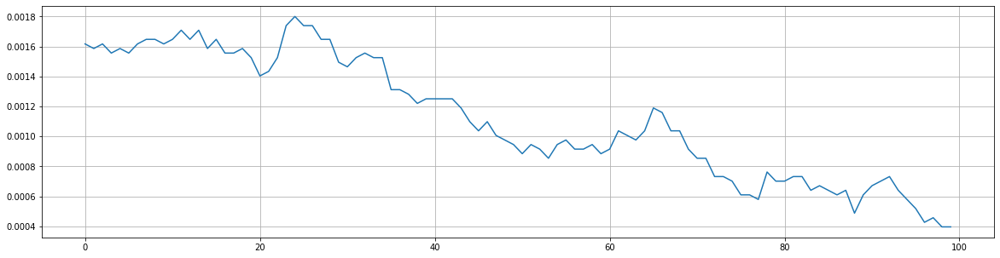

In [ ]:
n0 = 9000
n1 = 9100
plt.figure(figsize=(20, 5))
plt.plot(x[n0:n1])
plt.grid()

In [ ]:
zero_crossings = librosa.zero_crossings(x[n0:n1], pad=False)
zero_crossings.shape

(100,)

In [ ]:
print(sum(zero_crossings))

0


2. Spectral Centroid

In [ ]:
spectral_centroids = librosa.feature.spectral_centroid(x, sr=sr)[0]
spectral_centroids.shape

(2584,)

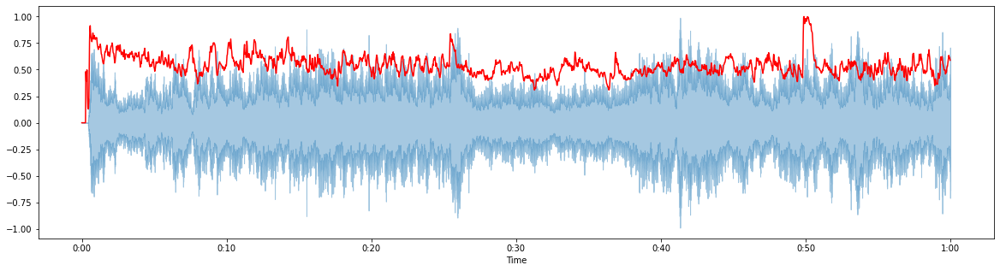

In [ ]:
# Computing the time variable for visualization
plt.figure(figsize=(20,5))
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)

# Normalising the spectral centroid for visualisation
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)

#Plotting the Spectral Centroid along the waveform
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_centroids), color='r')

3.Spectral Rolloff

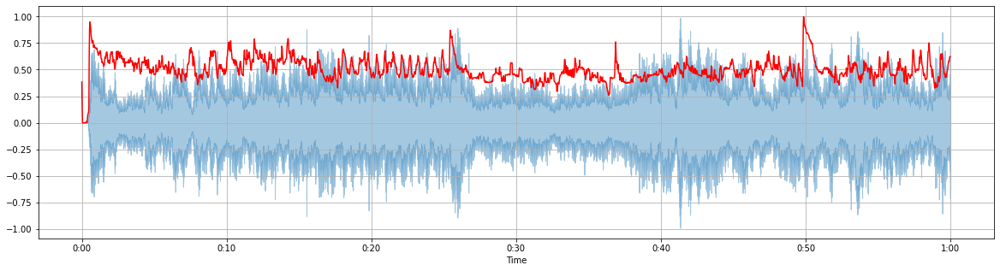

In [ ]:
plt.figure(figsize=(20,5))
spectral_rolloff = librosa.feature.spectral_rolloff(x+0.01, sr=sr)[0]
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_rolloff), color='r')
plt.grid()

4.MFCC

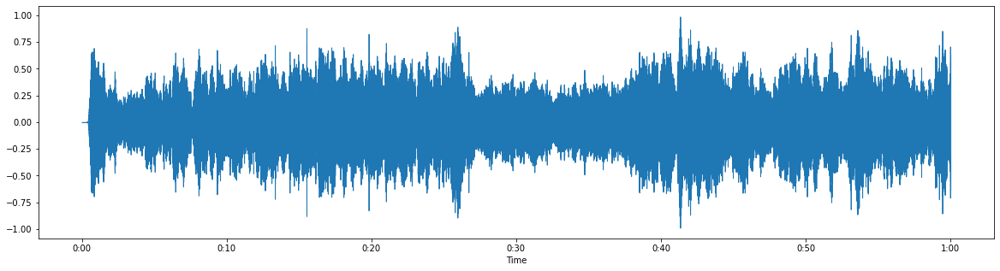

In [ ]:
plt.figure(figsize=(20,5))
x, fs = librosa.load('StarWars60.wav')
librosa.display.waveshow(x, sr=sr)

(20, 2584)


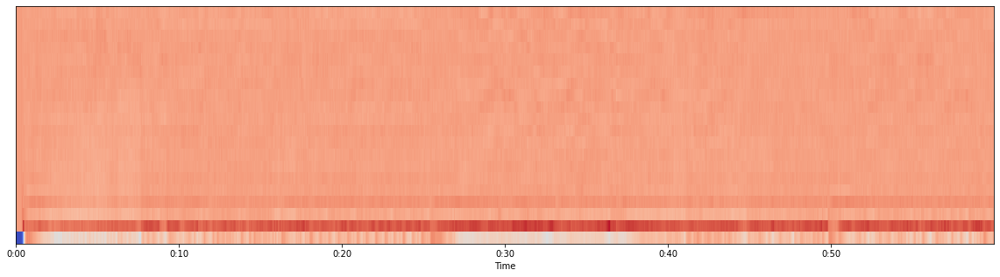

In [ ]:


# MFCC
plt.figure(figsize=(20,5))
mfccs = librosa.feature.mfcc(x, sr=sr)
print(mfccs.shape)

librosa.display.specshow(mfccs, sr=sr, x_axis='time')



## Feature scaling

In [ ]:
mfccs = sklearn.preprocessing.scale(mfccs, axis=1)
print(mfccs.mean(axis=1))
print(mfccs.var(axis=1))

[ 5.9051040e-09  1.1810208e-08 -5.9051040e-09 -5.9051040e-09
 -1.1810208e-08  0.0000000e+00 -1.7715312e-08  1.1810208e-08
  0.0000000e+00  8.8576559e-09  1.1810208e-08  0.0000000e+00
 -4.4288280e-09 -8.8576559e-09 -5.9051040e-09 -5.9051040e-09
  0.0000000e+00  1.1810208e-08  1.1810208e-08  0.0000000e+00]
[1.        1.        1.        1.        1.        1.0000001 0.9999999
 0.9999999 1.        1.        1.0000001 1.        1.        1.
 0.9999999 1.        1.        1.        1.        1.0000001]


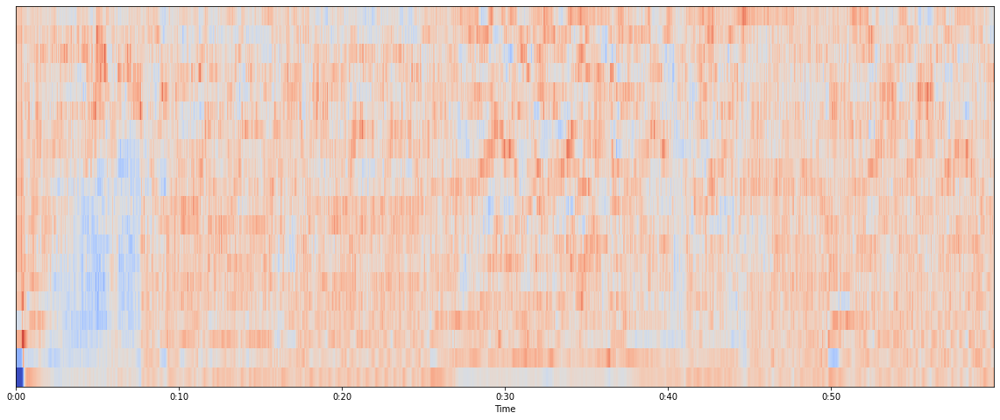

In [ ]:


plt.figure(figsize=(20,8))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')



## Chroma Frequencies

In [ ]:
# Loadign the file
x, sr = librosa.load('StarWars60.wav')
ipd.Audio(x, rate=sr)

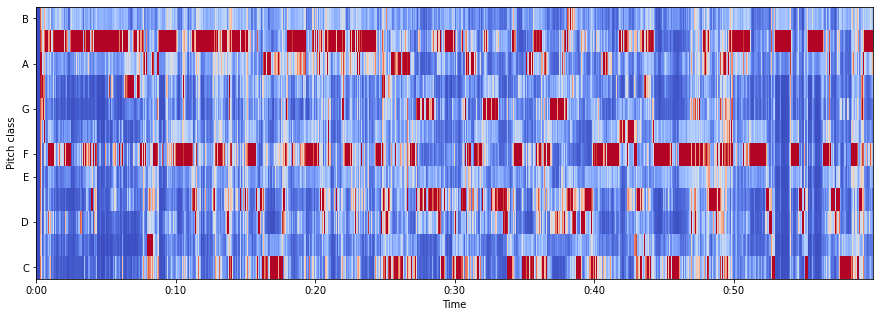

In [ ]:
hop_length = 512
chromagram = librosa.feature.chroma_stft(x, sr=sr, hop_length=hop_length)
plt.figure(figsize=(15, 5))
librosa.display.specshow(chromagram, x_axis='time', y_axis='chroma', hop_length=hop_length, cmap='coolwarm')

## Writing to CSV file

In [ ]:

import csv


In [ ]:
header = 'songname chroma_stft rmse spectral_centroid spectral_bandwidth rolloff zero_crossing_rate'
for i in range(1, 21):
    header += f' mfcc{i}'
header += ' label'
header = header.split()

In [ ]:

file = open('dataset.csv', 'w', newline='')
with file:
    writer = csv.writer(file)
    writer.writerow(header)
    
genre = 'classical'
songname = 'StarWars60.wav'
songtitle = 'StarWars60.wav'
y, sr = librosa.load(songname, mono=True, duration=30)
chroma_stft = librosa.feature.chroma_stft(y=y, sr=sr)
rmse = librosa.feature.rms(y=y)
spec_cent = librosa.feature.spectral_centroid(y=y, sr=sr)
spec_bw = librosa.feature.spectral_bandwidth(y=y, sr=sr)
rolloff = librosa.feature.spectral_rolloff(y=y, sr=sr)
zcr = librosa.feature.zero_crossing_rate(y)
mfcc = librosa.feature.mfcc(y=y, sr=sr)
to_append = f'{songtitle} {np.mean(chroma_stft)} {np.mean(rmse)} {np.mean(spec_cent)} {np.mean(spec_bw)} {np.mean(rolloff)} {np.mean(zcr)}'
    
        
for e in mfcc:
    to_append += f' {np.mean(e)}'
to_append += f' {genre}'
file = open('dataset.csv', 'a', newline='')
with file:
    writer = csv.writer(file)
    writer.writerow(to_append.split())

# File 2: Pink Panther

In [ ]:
import librosa
audio_path2 = 'PinkPanther60.wav'
x , sr = librosa.load(audio_path2)

In [ ]:
import IPython.display as ipd
ipd.Audio(audio_path2)

## Visualizing Audio

waveform

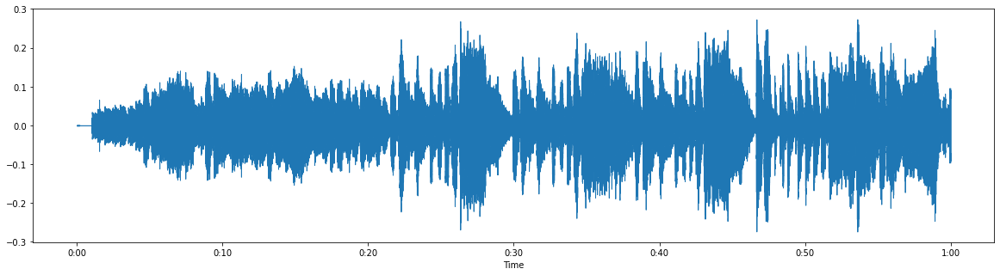

In [ ]:
plt.figure(figsize=(20, 5))
librosa.display.waveshow(x, sr=sr)

spectogram

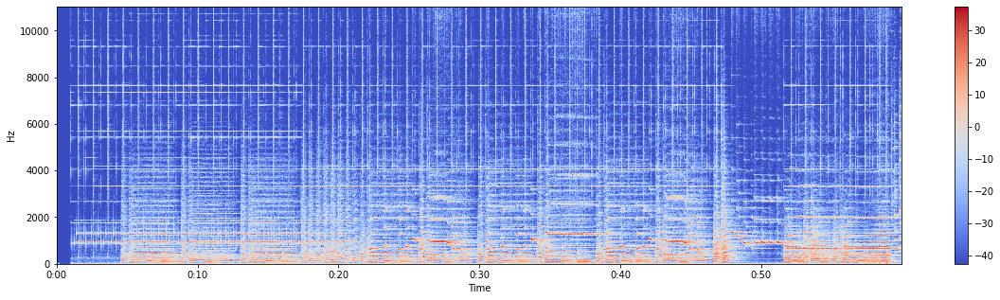

In [ ]:
X = librosa.stft(x)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(20, 5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar()

log frequency axis

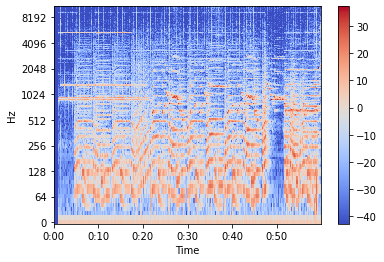

In [ ]:
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.colorbar()

## Feature Extraction

In [ ]:
x, sr = librosa.load('PinkPanther60.wav')
ipd.Audio(x, rate=sr)

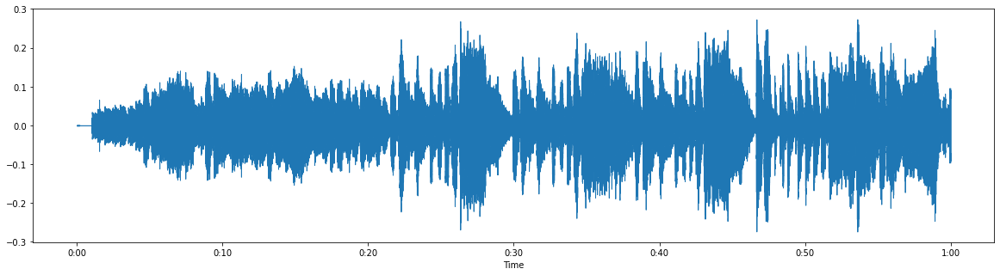

In [ ]:
#Plot the signal:
plt.figure(figsize=(20, 5))
librosa.display.waveshow(x, sr=sr)

1. Zero Crossing Rate

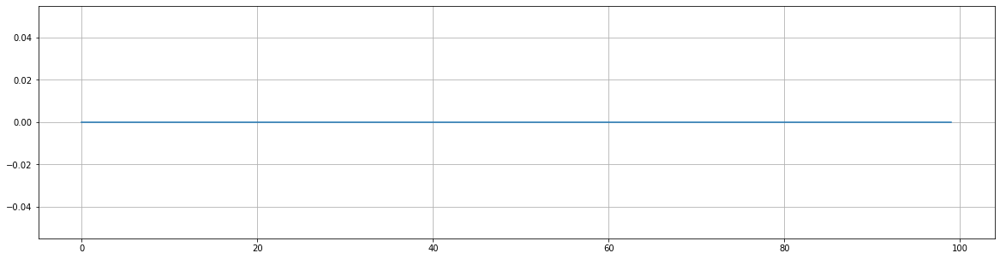

In [ ]:
n0 = 9000
n1 = 9100
plt.figure(figsize=(20, 5))
plt.plot(x[n0:n1])
plt.grid()

In [ ]:
zero_crossings = librosa.zero_crossings(x[n0:n1], pad=False)
zero_crossings.shape

(100,)

In [ ]:
print(sum(zero_crossings))

0


2.Spectral Centroid

In [ ]:
spectral_centroids = librosa.feature.spectral_centroid(x, sr=sr)[0]
spectral_centroids.shape

(2584,)

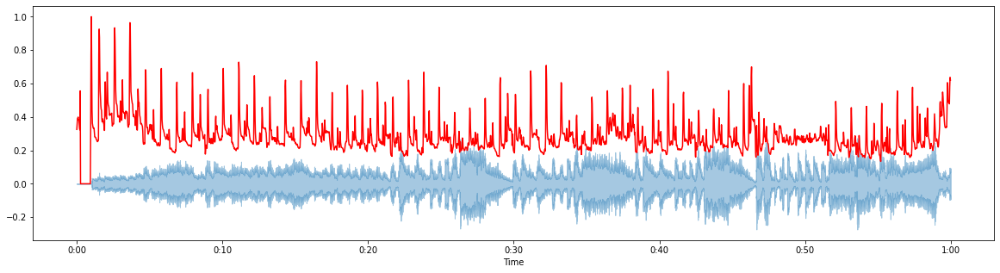

In [ ]:
# Computing the time variable for visualization
plt.figure(figsize=(20,5))
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)

# Normalising the spectral centroid for visualisation
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)

#Plotting the Spectral Centroid along the waveform
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_centroids), color='r')

3.Spectral Rolloff

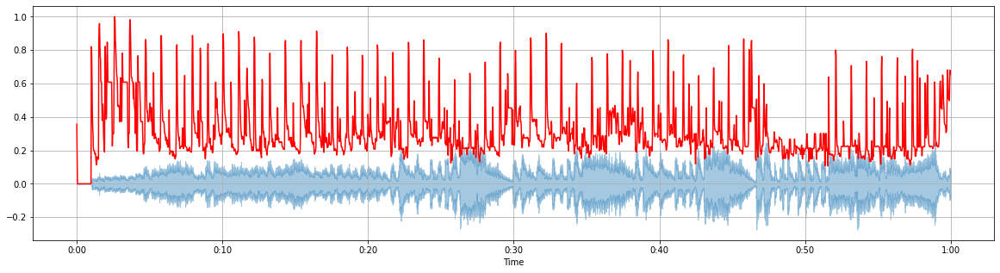

In [ ]:
plt.figure(figsize=(20,5))
spectral_rolloff = librosa.feature.spectral_rolloff(x+0.01, sr=sr)[0]
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_rolloff), color='r')
plt.grid()

4.MFCC

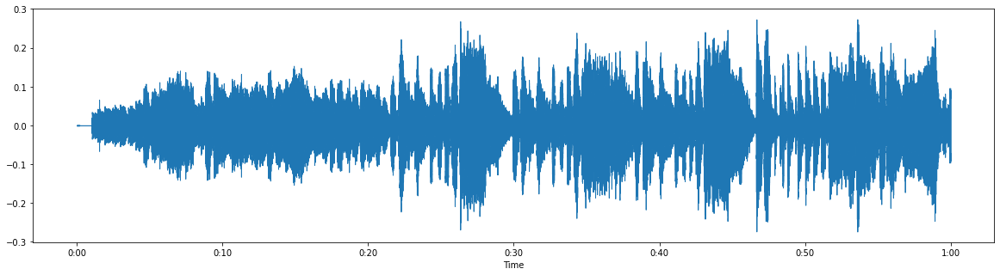

In [ ]:
plt.figure(figsize=(20,5))
x, fs = librosa.load('PinkPanther60.wav')
librosa.display.waveshow(x, sr=sr)

(20, 2584)


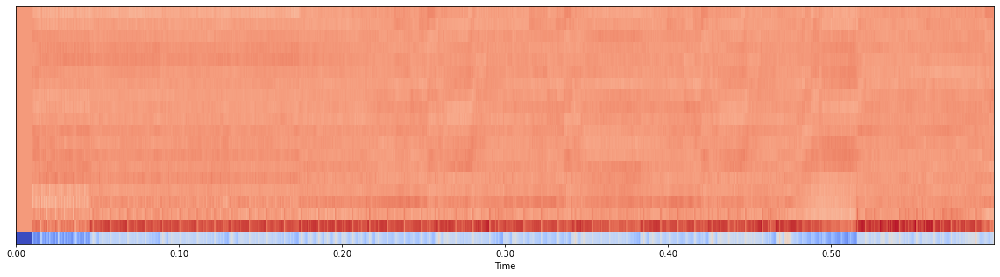

In [ ]:
# MFCC
plt.figure(figsize=(20,5))
mfccs = librosa.feature.mfcc(x, sr=sr)
print(mfccs.shape)

librosa.display.specshow(mfccs, sr=sr, x_axis='time')

## Feature Scaling

In [ ]:
mfccs = sklearn.preprocessing.scale(mfccs, axis=1)
print(mfccs.mean(axis=1))
print(mfccs.var(axis=1))

[ 1.1810208e-08 -1.1810208e-08 -2.9525520e-09  1.1810208e-08
 -2.3620416e-08 -1.1810208e-08  2.0667864e-08  1.1810208e-08
  0.0000000e+00  1.1810208e-08  0.0000000e+00  0.0000000e+00
  0.0000000e+00 -5.9051040e-09  0.0000000e+00  0.0000000e+00
  2.3620416e-08  5.9051040e-09 -1.1810208e-08  2.3620416e-08]
[0.9999998 1.        0.9999998 1.        0.9999999 1.        0.9999999
 0.9999999 0.9999999 1.        1.0000001 1.        1.        1.0000001
 0.9999999 0.9999999 1.        0.9999999 1.        1.       ]


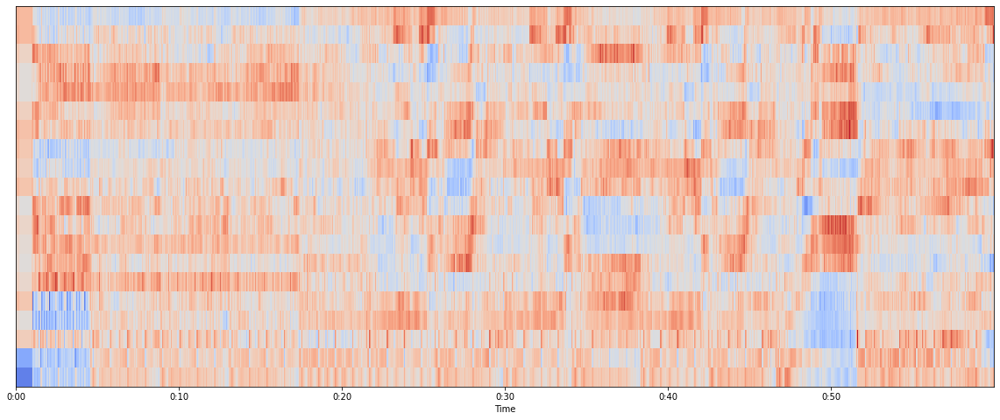

In [ ]:
plt.figure(figsize=(20,8))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')


## Chroma Frequencies


In [ ]:
# Loadign the file
x, sr = librosa.load('PinkPanther60.wav')
ipd.Audio(x, rate=sr)

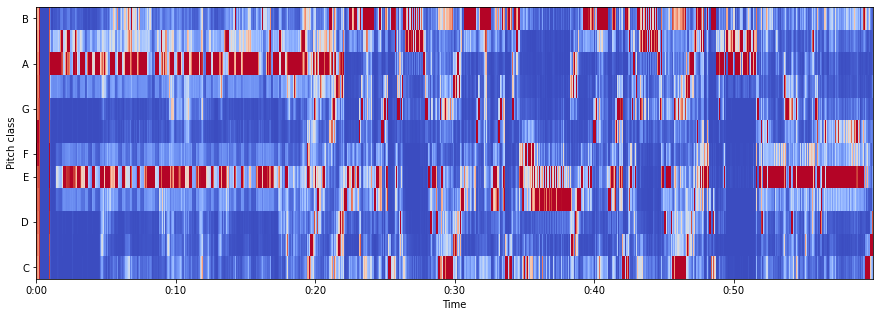

In [ ]:
hop_length = 512
chromagram = librosa.feature.chroma_stft(x, sr=sr, hop_length=hop_length)
plt.figure(figsize=(15, 5))
librosa.display.specshow(chromagram, x_axis='time', y_axis='chroma', hop_length=hop_length, cmap='coolwarm')

In [ ]:

genre = 'pop'
songname = 'PinkPanther60.wav'
songtitle = 'PinkPanther60.wav'
y, sr = librosa.load(songname, mono=True, duration=30)
chroma_stft = librosa.feature.chroma_stft(y=y, sr=sr)
rmse = librosa.feature.rms(y=y)
spec_cent = librosa.feature.spectral_centroid(y=y, sr=sr)
spec_bw = librosa.feature.spectral_bandwidth(y=y, sr=sr)
rolloff = librosa.feature.spectral_rolloff(y=y, sr=sr)
zcr = librosa.feature.zero_crossing_rate(y)
mfcc = librosa.feature.mfcc(y=y, sr=sr)
to_append = f'{songtitle} {np.mean(chroma_stft)} {np.mean(rmse)} {np.mean(spec_cent)} {np.mean(spec_bw)} {np.mean(rolloff)} {np.mean(zcr)}'
    
        
for e in mfcc:
    to_append += f' {np.mean(e)}'
to_append += f' {genre}'
file = open('dataset.csv', 'a', newline='')
with file:
    writer = csv.writer(file)
    writer.writerow(to_append.split())